In [ ]:
!pip install embree
!pip install rtree
!pip install shapely
!pip install trimesh
!pip install numpy
!pip install scipy
!pip install open3d
!pip install pyglet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!git clone https://github.com/coreqode/orientation_data/
!mv /content/orientation_data/data /content/data

fatal: destination path 'orientation_data' already exists and is not an empty directory.
mv: cannot stat '/content/orientation_data/data': No such file or directory


In [ ]:
import open3d as o3d
import trimesh
import os
import numpy as np
import scipy
import matplotlib.pyplot as plt
import copy
import pyglet

# Trimesh based visualizer 

In [ ]:
def visualizer(root, mesh_name):
    if 'list' in str(type(mesh_name)):
        scene = trimesh.scene.Scene()
        for name in mesh_name:
            mesh_path = os.path.join(root,name)
            mesh = trimesh.load(mesh_path, process=False, prefer_colors='vertex')
            scene.add_geometry(mesh)
        return scene
    
    mesh_path = os.path.join(root,mesh_name)
    mesh = trimesh.load(mesh_path, process=False)
    scene = trimesh.scene.Scene()
    scene.add_geometry(mesh)
    return scene

# Download the required data
Download the data directory and save it in your Google drive.
In the next cell, make sure to enter your drive/local appropriate location of the data to access the data present.
If time permits or as an exercise, you can also try the following experiments on the point clouds or meshes of your own choice.

## IO operations

In [ ]:
src = '/content/data/'
dest = '/content/output/'
os.makedirs(dest, exist_ok=True)

# Point Cloud

In [ ]:
# read point cloud
filename = 'bunny_pc.ply'
pcd = o3d.io.read_point_cloud(os.path.join(src, filename))

# write point cloud
save_name = 'bunny_pc_new.ply'
o3d.io.write_point_cloud(os.path.join(dest, save_name), pcd)
print(len(np.asarray(pcd.points)))
scene = visualizer(dest, save_name)
scene.show()

8958


# Triangle Mesh

In [ ]:
# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))

# write triangle mesh
save_name = 'bunny_mesh_new.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name), mesh)

# # visualize
scene = visualizer(dest, save_name)
scene.show()

## Understanding Point Cloud

In [ ]:
# read point cloud
filename = 'bunny_pc.ply'
pcd = o3d.io.read_point_cloud(os.path.join(src, filename))

# access informaton using numpy
points = np.asarray(pcd.points)
colors = np.asarray(pcd.colors)
normals = np.asarray(pcd.normals)
print(points.shape, colors.shape, normals.shape)

(8958, 3) (8958, 3) (8958, 3)


# Understanding Triangle Mesh

In [ ]:
# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))

# access informaton using numpy
vertices = np.asarray(mesh.vertices)
faces = np.asarray(mesh.triangles)
colors = np.asarray(mesh.vertex_colors)
normals = np.asarray(mesh.vertex_normals)
print(vertices.shape, faces.shape, colors.shape, normals.shape)

(15258, 3) (30338, 3) (0, 3) (15258, 3)


# Transformations

## Rotation


In [ ]:
# random rotation
R = scipy.spatial.transform.Rotation.random(1)
R = R.as_matrix()
R = np.array(R).reshape(3,3)

# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))
mesh_rot = mesh.rotate(R)
mesh.paint_uniform_color([1,0,0])

# write triangle mesh
save_name = 'mesh_rotated.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name), mesh_rot)

# visualize
scene = visualizer(dest, [save_name,'bunny_mesh_new.obj'])
scene.show()

## Translation


In [ ]:
# random translation
T = np.random.uniform(100,1000,(3,))

# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))
mesh_translated = mesh.translate(T)
mesh.paint_uniform_color([1,0,0])

# write triangle mesh
save_name = 'bunny_trans.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name), mesh_translated)

# visualize
scene = visualizer(dest, [save_name, "bunny_mesh_new.obj"])
scene.show()

## Scale

In [ ]:
# scaling paramter
S = 2.0
center = np.array([0,0,0])

# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))
mesh_scaled = mesh.scale(S, center)
mesh.paint_uniform_color([1,0,0])

# write triangle mesh
save_name = 'mesh_scaled.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name), mesh_scaled)

# visualize
scene = visualizer(dest, [save_name,'bunny_mesh_new.obj'])
scene.show()

## Transformation Matrix

In [ ]:
# random rotation
R = scipy.spatial.transform.Rotation.random(1)
R = R.as_matrix()
R = np.array(R).reshape(3,3)

# random translation
T = np.random.uniform(-500,500,(3,))

# scaling factor
scale = 2.0
print(R.shape, T.shape, scale)

(3, 3) (3,) 2.0


In [ ]:
# create transformation matrices
RT = np.eye(4)
RT[:3,:3] = R
RT[:3,3] = T

S = np.eye(4)
S[:3,:3] = scale*np.eye(3)

# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))

# apply transformations
mesh.transform(S)
mesh.transform(RT)

# assign different color
mesh.paint_uniform_color([1,0,0])

# write triangle mesh
save_name = 'mesh_transformed.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name), mesh)

# visualize
scene = visualizer(dest, [save_name,'bunny_mesh_new.obj'])
scene.show()

## Different order of transformations

In [ ]:
# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))
# apply transformations
mesh.transform(S)
mesh.transform(RT)
# assign different color
mesh.paint_uniform_color([1,0.5,0])
# write triangle mesh
save_name_1 = 'mesh_transformed_1.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name_1), mesh)


# read triangle mesh
filename = 'bunny_mesh.obj'
mesh = o3d.io.read_triangle_mesh(os.path.join(src, filename))
# apply transformations (different order)
mesh.transform(RT)
mesh.transform(S)
# assign different color
mesh.paint_uniform_color([0.3,1,0])
# write triangle mesh
save_name_2 = 'mesh_transformed_2.obj'
o3d.io.write_triangle_mesh(os.path.join(dest, save_name_2), mesh)

# visualize
scene = visualizer(dest, [save_name_1, save_name_2, 'bunny_mesh_new.obj'])
scene.show()

# Working with RGB-D data

In [ ]:
# data loading
redwood_rgbd = o3d.data.SampleRedwoodRGBDImages()
color_raw = o3d.io.read_image(redwood_rgbd.color_paths[0])
depth_raw = o3d.io.read_image(redwood_rgbd.depth_paths[0])

# create RGBD image ( 3 + 1 = 4 channels )
rgbd = o3d.geometry.RGBDImage.create_from_color_and_depth(color_raw, depth_raw, convert_rgb_to_intensity=False)

print("Color info : ",rgbd.color)
print()
print("Depth info : ",rgbd.depth)

[Open3D INFO] Downloading https://github.com/isl-org/open3d_downloads/releases/download/20220301-data/SampleRedwoodRGBDImages.zip
[Open3D INFO] Downloaded to /root/open3d_data/download/SampleRedwoodRGBDImages/SampleRedwoodRGBDImages.zip
[Open3D INFO] Created directory /root/open3d_data/extract/SampleRedwoodRGBDImages.
[Open3D INFO] Extracting /root/open3d_data/download/SampleRedwoodRGBDImages/SampleRedwoodRGBDImages.zip.
[Open3D INFO] Extracted to /root/open3d_data/extract/SampleRedwoodRGBDImages.
Color info :  Image of size 640x480, with 3 channels.
Use numpy.asarray to access buffer data.

Depth info :  Image of size 640x480, with 1 channels.
Use numpy.asarray to access buffer data.


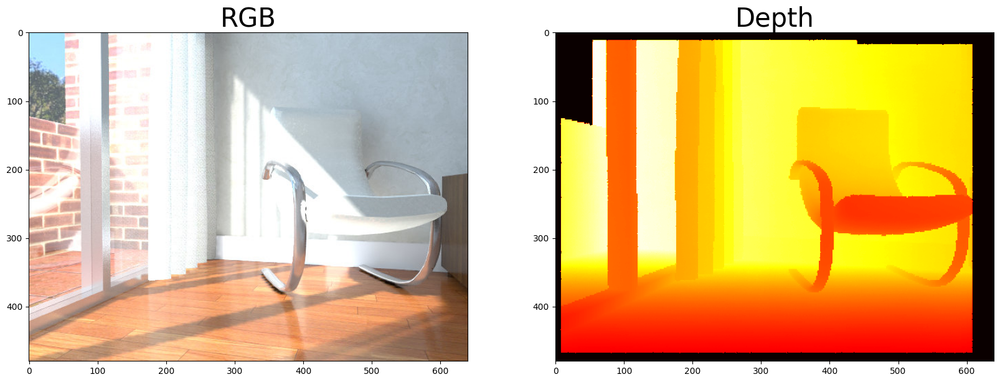

In [ ]:
# plot
fig, ax = plt.subplots(nrows=1, ncols=2)
fig.set_size_inches(20,40)
ax[0].imshow(rgbd.color)
ax[0].set_title('RGB',size=30)
ax[1].imshow(rgbd.depth,cmap='hot')
ax[1].set_title('Depth',size=30)
plt.show()

# Point Cloud from RGBD

In [ ]:
# Camera intrinsics
cam_intrinsics =  o3d.camera.PinholeCameraIntrinsic(
        o3d.camera.PinholeCameraIntrinsicParameters.PrimeSenseDefault)

cam_intrinsics.intrinsic_matrix

array([[525. ,   0. , 319.5],
       [  0. , 525. , 239.5],
       [  0. ,   0. ,   1. ]])

In [ ]:
# point cloud from RGBD
pcd = o3d.geometry.PointCloud.create_from_rgbd_image(rgbd, cam_intrinsics)

# Flip it, otherwise the pointcloud will be upside down
pcd.transform([[1, 0, 0, 0], [0, -1, 0, 0], [0, 0, -1, 0], [0, 0, 0, 1]])

# write point cloud
save_name = 'pcd_from_rgbd.ply'
o3d.io.write_point_cloud(os.path.join(dest, save_name), pcd)

# visualize
scene = visualizer(dest, [save_name])
scene.show()

# Point Cloud Registration

In [ ]:
# # Camera intrinsics
# cam_intrinsics =  o3d.camera.PinholeCameraIntrinsic(
#         o3d.camera.PinholeCameraIntrinsicParameters.PrimeSenseDefault)

# # data loading (source)
# redwood_rgbd = o3d.data.SampleRedwoodRGBDImages()
# color_raw = o3d.io.read_image(redwood_rgbd.color_paths[1])
# depth_raw = o3d.io.read_image(redwood_rgbd.depth_paths[1])
# # create RGBD image ( 3 + 1 = 4 channels )
# rgbd = o3d.geometry.RGBDImage.create_from_color_and_depth(color_raw, depth_raw, convert_rgb_to_intensity=False)
# # point cloud from RGBD
# pcd_source = o3d.geometry.PointCloud.create_from_rgbd_image(rgbd, cam_intrinsics)

# # data loading (target)
# redwood_rgbd = o3d.data.SampleRedwoodRGBDImages()
# color_raw = o3d.io.read_image(redwood_rgbd.color_paths[2])
# depth_raw = o3d.io.read_image(redwood_rgbd.depth_paths[2])
# # create RGBD image ( 3 + 1 = 4 channels )
# rgbd = o3d.geometry.RGBDImage.create_from_color_and_depth(color_raw, depth_raw, convert_rgb_to_intensity=False)
# # point cloud from RGBD
# pcd_target = o3d.geometry.PointCloud.create_from_rgbd_image(rgbd, cam_intrinsics)

In [ ]:
# # write point clouds
# save_name_source = 'pcd_source.ply'
# save_name_target = 'pcd_target.ply'
# o3d.io.write_point_cloud(os.path.join(dest, save_name_source), pcd_source)
# o3d.io.write_point_cloud(os.path.join(dest, save_name_target), pcd_target)

# # visualize
# scene = visualizer(dest, [save_name_source, save_name_target])
# scene.show()

In [ ]:
# pcd_source_temp = copy.deepcopy(pcd_source)
# pcd_target_temp = copy.deepcopy(pcd_target)

# pcd_source_temp.paint_uniform_color([1.0, 0.8, 0.4]) # --> Blue
# # pcd_target_temp.paint_uniform_color([0.4,0.8,1.0]) # --> Orange

# # write point clouds
# save_name_source_temp = 'pcd_source_temp.ply'
# save_name_target_temp = 'pcd_target_temp.ply'
# o3d.io.write_point_cloud(os.path.join(dest, save_name_source_temp), pcd_source_temp)
# o3d.io.write_point_cloud(os.path.join(dest, save_name_target_temp), pcd_target_temp)

# # visualize
# scene = visualizer(dest, [save_name_source_temp, save_name_target_temp])
# scene.show()

#### Exercise : Random Transformation

Construct a random RT matrix (no scaling) and apply it to the Source Point Cloud.

In [ ]:
filename = 'pcd_from_rgbd.ply'
pcd_source= o3d.io.read_point_cloud(os.path.join(dest, filename))
# random rotation
R = scipy.spatial.transform.Rotation.random(1)
R = R.as_matrix()
R = np.array(R).reshape(3,3)

# random translation
T = np.random.uniform(-1,1,(3,))

# create transformation matrices
RT = np.eye(4)
RT[:3,:3] = R
RT[:3,3] = T

# apply RT to pcd_source
pcd_source.transform(RT)

# write transformed point cloud
save_name_source = 'pcd_target.ply'
save_name_target = 'pcd_from_rgbd.ply'
o3d.io.write_point_cloud(os.path.join(dest, save_name_source), pcd_source)
# visualize
scene = visualizer(dest, [save_name_source, save_name_target])
scene.show()

#### Global Registration

In [ ]:
# def preprocess_point_cloud(pcd, voxel_size):
#     print(":: Downsample with a voxel size %.3f." % voxel_size)
#     pcd_down = pcd.voxel_down_sample(voxel_size)

#     radius_normal = voxel_size * 2
#     print(":: Estimate normal with search radius %.3f." % radius_normal)
#     pcd_down.estimate_normals(
#         o3d.geometry.KDTreeSearchParamHybrid(radius=radius_normal, max_nn=30))

#     radius_feature = voxel_size * 5
#     print(":: Compute FPFH feature with search radius %.3f." % radius_feature)
#     pcd_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
#         pcd_down,
#         o3d.geometry.KDTreeSearchParamHybrid(radius=radius_feature, max_nn=100))
#     return pcd_down, pcd_fpfh

# filename = 'pcd_from_rgbd.ply'
# pcd_source= o3d.io.read_point_cloud(os.path.join(dest, filename))
# filename = 'pcd_target.ply'
# pcd_target= o3d.io.read_point_cloud(os.path.join(dest, filename))
# voxel_size = 0.05
# source_down, source_fpfh = preprocess_point_cloud(pcd_source, voxel_size)
# target_down, target_fpfh = preprocess_point_cloud(pcd_target, voxel_size)

:: Downsample with a voxel size 0.050.
:: Estimate normal with search radius 0.100.
:: Compute FPFH feature with search radius 0.250.
:: Downsample with a voxel size 0.050.
:: Estimate normal with search radius 0.100.
:: Compute FPFH feature with search radius 0.250.


In [ ]:
# distance_threshold = voxel_size*1.5
# result = o3d.pipelines.registration.registration_ransac_based_on_feature_matching(
#         source_down, target_down, source_fpfh, target_fpfh, True,
#         distance_threshold,
#         o3d.pipelines.registration.TransformationEstimationPointToPoint(False),
#         3, [
#             o3d.pipelines.registration.CorrespondenceCheckerBasedOnEdgeLength(
#                 0.9),
#             o3d.pipelines.registration.CorrespondenceCheckerBasedOnDistance(
#                 distance_threshold)
#         ], o3d.pipelines.registration.RANSACConvergenceCriteria(100000, 0.999))

# RT_global = result.transformation
# RT_global

In [ ]:
# # apply RT_golbal to pcd_source
# pcd_source_temp = copy.deepcopy(pcd_source)
# pcd_source_temp.transform(RT_global)

# # write transformed point cloud
# save_name_source_temp = 'pcd_source_transformed.ply'
# o3d.io.write_point_cloud(os.path.join(dest, save_name_source_temp), pcd_source_temp)

# # visualize
# scene = visualizer(dest, [save_name_source_temp, 'pcd_target.ply'])
# scene.show()

#### Local Refinement (ICP)

Point-to-Point ICP

In [ ]:
threshold = 0.1
p2p_icp = o3d.pipelines.registration.registration_icp(
    pcd_source, pcd_target, threshold, RT_global,
    o3d.pipelines.registration.TransformationEstimationPointToPoint(),
    o3d.pipelines.registration.ICPConvergenceCriteria(max_iteration=30))

In [ ]:
RT_refined = p2p_icp.transformation
RT_refined

array([[ 0.1807592 , -0.90647065,  0.38162426,  0.87865921],
       [-0.96860248, -0.0967291 ,  0.22902559, -0.23480192],
       [-0.17069081, -0.41104068, -0.89549439, -0.43421199],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [ ]:
# apply RT_golbal to pcd_source
pcd_source_temp = copy.deepcopy(pcd_source)
pcd_source_temp.transform(RT_refined)

# write transformed point cloud
save_name_source_temp = 'pcd_source_transformed.ply'
o3d.io.write_point_cloud(os.path.join(dest, save_name_source_temp), pcd_source_temp)

# visualize
scene = visualizer(dest, [save_name_source_temp, 'pcd_target.ply'])
scene.show()